In [2]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="2"

In [3]:
!nvidia-smi

Mon Feb 24 21:49:37 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 570.86.15              Driver Version: 570.86.15      CUDA Version: 12.8     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100 80GB PCIe          On  |   00000000:17:00.0 Off |                    0 |
| N/A   39C    P0             57W /  300W |       1MiB /  81920MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

In [4]:
from transformers import Qwen2_5_VLForConditionalGeneration, AutoTokenizer, AutoProcessor, AutoModel 
from qwen_vl_utils import process_vision_info

import torch
import json
import random
import io
import ast
from PIL import Image, ImageDraw, ImageFont
from PIL import ImageColor

import Levenshtein
import cv2
import numpy as np
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt

/gpfs/projects/CascanteBonillaGroup/jmurrugarral/anaconda3/envs/py10-QWEN/lib/python3.10/site-packages/transformers/utils/hub.py:127: FutureWarning: Using `TRANSFORMERS_CACHE` is deprecated and will be removed in v5 of Transformers. Use `HF_HOME` instead.
  warnings.warn(


In [5]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam_checkpoint = "../sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

Sam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 1280, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0-31): 32 x Block(
        (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=1280, out_features=3840, bias=True)
          (proj): Linear(in_features=1280, out_features=1280, bias=True)
        )
        (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (lin1): Linear(in_features=1280, out_features=5120, bias=True)
          (lin2): Linear(in_features=5120, out_features=1280, bias=True)
          (act): GELU(approximate='none')
        )
      )
    )
    (neck): Sequential(
      (0): Conv2d(1280, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): LayerNorm2d()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): LayerNorm2d

In [6]:


# default: Load the model on the available device(s)
model = Qwen2_5_VLForConditionalGeneration.from_pretrained(
    "Qwen/Qwen2.5-VL-7B-Instruct", torch_dtype="auto", device_map="auto"
)

# default processer
processor = AutoProcessor.from_pretrained("Qwen/Qwen2.5-VL-7B-Instruct")


Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

In [7]:
import os
import sys

# __dir__ = os.path.dirname(os.path.abspath(__file__))
__dir__ = os.path.dirname(os.path.abspath(os.getcwd()))
sys.path.append(__dir__)
sys.path.insert(0, os.path.abspath(os.path.join(__dir__, "../..")))
#sys.path.insert(0, os.path.abspath(os.path.join(__dir__, "PaddleOCR")))


os.environ["FLAGS_allocator_strategy"] = "auto_growth"

import cv2
import numpy as np
import time
import sys

import tools.infer.utility as utility
from ppocr.utils.logging import get_logger
from ppocr.utils.utility import get_image_file_list, check_and_read
from ppocr.data import create_operators, transform
from ppocr.postprocess import build_post_process

logger = get_logger()


class TextE2E(object):
    def __init__(self, args):
        self.args = args
        self.e2e_algorithm = args.e2e_algorithm
        self.use_onnx = args.use_onnx
        pre_process_list = [
            {"E2EResizeForTest": {}},
            {
                "NormalizeImage": {
                    "std": [0.229, 0.224, 0.225],
                    "mean": [0.485, 0.456, 0.406],
                    "scale": "1./255.",
                    "order": "hwc",
                }
            },
            {"ToCHWImage": None},
            {"KeepKeys": {"keep_keys": ["image", "shape"]}},
        ]
        postprocess_params = {}
        if self.e2e_algorithm == "PGNet":
            pre_process_list[0] = {
                "E2EResizeForTest": {
                    "max_side_len": args.e2e_limit_side_len,
                    "valid_set": "totaltext",
                }
            }
            postprocess_params["name"] = "PGPostProcess"
            postprocess_params["score_thresh"] = args.e2e_pgnet_score_thresh
            postprocess_params["character_dict_path"] = args.e2e_char_dict_path
            postprocess_params["valid_set"] = args.e2e_pgnet_valid_set
            postprocess_params["mode"] = args.e2e_pgnet_mode
        else:
            logger.info("unknown e2e_algorithm:{}".format(self.e2e_algorithm))
            sys.exit(0)

        self.preprocess_op = create_operators(pre_process_list)
        self.postprocess_op = build_post_process(postprocess_params)
        (
            self.predictor,
            self.input_tensor,
            self.output_tensors,
            _,
        ) = utility.create_predictor(
            args, "e2e", logger
        )  # paddle.jit.load(args.det_model_dir)
        # self.predictor.eval()

    def clip_det_res(self, points, img_height, img_width):
        for pno in range(points.shape[0]):
            points[pno, 0] = int(min(max(points[pno, 0], 0), img_width - 1))
            points[pno, 1] = int(min(max(points[pno, 1], 0), img_height - 1))
        return points

    def filter_tag_det_res_only_clip(self, dt_boxes, image_shape):
        img_height, img_width = image_shape[0:2]
        dt_boxes_new = []
        for box in dt_boxes:
            box = self.clip_det_res(box, img_height, img_width)
            dt_boxes_new.append(box)
        dt_boxes = np.array(dt_boxes_new)
        return dt_boxes

    def __call__(self, img):
        ori_im = img.copy()
        data = {"image": img}
        data = transform(data, self.preprocess_op)
        img, shape_list = data
        if img is None:
            return None, 0
        img = np.expand_dims(img, axis=0)
        shape_list = np.expand_dims(shape_list, axis=0)
        img = img.copy()
        starttime = time.time()

        if self.use_onnx:
            input_dict = {}
            input_dict[self.input_tensor.name] = img
            outputs = self.predictor.run(self.output_tensors, input_dict)
            preds = {}
            preds["f_border"] = outputs[0]
            preds["f_char"] = outputs[1]
            preds["f_direction"] = outputs[2]
            preds["f_score"] = outputs[3]
        else:
            self.input_tensor.copy_from_cpu(img)
            self.predictor.run()
            outputs = []
            for output_tensor in self.output_tensors:
                output = output_tensor.copy_to_cpu()
                outputs.append(output)

            preds = {}
            if self.e2e_algorithm == "PGNet":
                preds["f_border"] = outputs[0]
                preds["f_char"] = outputs[1]
                preds["f_direction"] = outputs[2]
                preds["f_score"] = outputs[3]
            else:
                raise NotImplementedError
        post_result = self.postprocess_op(preds, shape_list)
        points, strs = post_result["points"], post_result["texts"]
        dt_boxes = self.filter_tag_det_res_only_clip(points, ori_im.shape)
        elapse = time.time() - starttime
        return dt_boxes, strs, elapse

args = utility.parse_args()
args.e2e_algorithm="PGNet"
args.image_dir='../cropped_image.jpg'
args.e2e_model_dir="./inference/e2e_server_pgnetA_infer/"
args.use_gpu=False
args.e2e_pgnet_valid_set="totaltext"

text_detector = TextE2E(args)

draw_img_save = "./inference_results"
if not os.path.exists(draw_img_save):
    os.makedirs(draw_img_save)

which: no ccache in (/cm/shared/apps/slurm/current/sbin:/cm/shared/apps/slurm/current/bin:/gpfs/projects/CascanteBonillaGroup/jmurrugarral/anaconda3/envs/py10-QWEN/bin:/gpfs/projects/CascanteBonillaGroup/jmurrugarral/anaconda3/condabin:/cm/local/apps/environment-modules/4.5.3/bin:/usr/local/bin:/usr/bin:/usr/local/sbin:/usr/sbin:/cm/local/apps/environment-modules/current/bin:/gpfs/software/local/bin:/gpfs/home/jmurrugarral/bin:/gpfs/projects/CascanteBonillaGroup/jmurrugarral/anaconda3/envs/py10-QWEN/lib/python3.10/site-packages/decord)
/gpfs/projects/CascanteBonillaGroup/jmurrugarral/anaconda3/envs/py10-QWEN/lib/python3.10/site-packages/paddle/utils/cpp_extension/extension_utils.py:711: UserWarning: No ccache found. Please be aware that recompiling all source files may be required. You can download and install ccache from: https://github.com/ccache/ccache/blob/master/doc/INSTALL.md
  warnings.warn(warning_message)


In [12]:
#directory = "/home/jmurrugarral/VLM-Privacy"
#folder_path = "/home/jmurrugarral/datasets/BIV-Priv_Image/support_images"

directory = "/gpfs/projects/CascanteBonillaGroup/jmurrugarral/QWEN/PaddleOCR"
folder_path = "/gpfs/projects/CascanteBonillaGroup/datasets/BIV-Priv_Image/support_images"

In [104]:
from collections import Counter

additional_colors = [colorname for (colorname, colorcode) in ImageColor.colormap.items()]

def pil_to_opencv(img):
    return cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)

def opencv_to_pil(img):
    return Image.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    
def plot_bounding_boxes(im, bounding_boxes, input_width, input_height, image_width, image_height, json=False):
    """
    Plots bounding boxes on an image with markers for each a name, using PIL, normalized coordinates, and different colors.

    Args:
        img_path: The path to the image file.
        bounding_boxes: A list of bounding boxes containing the name of the object
         and their positions in normalized [y1 x1 y2 x2] format.
    """

    # Load the image
    img = im
    width, height = img.size
    # Create a drawing object
    draw = ImageDraw.Draw(img)

    # Define a list of colors
    colors = ['red','green','blue','yellow','orange','pink','purple','brown','gray','beige','turquoise','cyan','magenta','lime','navy','maroon',
    'teal','olive','coral','lavender','violet','gold','silver',] + additional_colors

    if json == False:

        # Parsing out the markdown fencing
        bounding_boxes = parse_json(bounding_boxes)

        #font = ImageFont.truetype("NotoSansCJK-Regular.ttc", size=14)

        try:
          json_output = ast.literal_eval(bounding_boxes)
        except Exception as e:
          end_idx = bounding_boxes.rfind('"}') + len('"}')
          truncated_text = bounding_boxes[:end_idx] + "]"
          json_output = ast.literal_eval(truncated_text)
    else:
        #json_output = ast.literal_eval(bounding_boxes)
        json_output = bounding_boxes

    bboxes = np.zeros((int(len(json_output)),4))
    labels = []

    # Iterate over the bounding boxes
    for i, bounding_box in enumerate(json_output):
      # Select a color from the list
      color = colors[i % len(colors)]

      bboxes[i,:] = np.array([int(bounding_box["bbox_2d"][0]/input_width * image_width),
                              int(bounding_box["bbox_2d"][1]/input_height * image_height),
                              int(bounding_box["bbox_2d"][2]/input_width * image_width),
                              int(bounding_box["bbox_2d"][3]/input_height * image_height)])



      # Convert normalized coordinates to absolute coordinates
      abs_y1 = int(bounding_box["bbox_2d"][1]/input_height * height)
      abs_x1 = int(bounding_box["bbox_2d"][0]/input_width * width)
      abs_y2 = int(bounding_box["bbox_2d"][3]/input_height * height)
      abs_x2 = int(bounding_box["bbox_2d"][2]/input_width * width)

      if abs_x1 > abs_x2:
        abs_x1, abs_x2 = abs_x2, abs_x1
        bboxes[i,0], bboxes[i,2] = bboxes[i,2], bboxes[i,0]


      if abs_y1 > abs_y2:
        abs_y1, abs_y2 = abs_y2, abs_y1
        bboxes[i,1], bboxes[i,3] = bboxes[i,3], bboxes[i,1]

      #bboxes[i,:] = np.array([abs_x1, abs_y1, abs_x2, abs_y2])

      # Draw the bounding box
      draw.rectangle(((abs_x1, abs_y1), (abs_x2, abs_y2)), outline=color, width=4)

      # Draw the text
      if "label" in bounding_box:
        draw.text((abs_x1 + 8, abs_y1 + 6), bounding_box["label"], fill=color)#, font=font)

      if "text_content" in bounding_box:
        labels.append(bounding_box["text_content"])

    # Display the image
    #img.show()

    return img, bboxes, labels

# @title Parsing JSON output
def parse_json(json_output):
    # Parsing out the markdown fencing
    lines = json_output.splitlines()
    for i, line in enumerate(lines):
        if line == "```json":
            json_output = "\n".join(lines[i+1:])  # Remove everything before "```json"
            json_output = json_output.split("```")[0]  # Remove everything after the closing "```"
            break  # Exit the loop once "```json" is found
    return json_output

def locate_private_content(img_full_path, prompt, temperature = 1, top_p = 0.8, grounding = True):

    max_new_tokens=1024
    messages = [
        {
            "role": "system",
            "content": "You are a helpful assistant"
        },
        {
            "role": "user",
            "content": [
                {
                    "type": "text",
                    "text": prompt
                },
                {
                  "image": img_full_path
                }
            ]
        }
    ]

    if isinstance(img_full_path, Image.Image):
        image = img_full_path
    else:
        image = Image.open(img_full_path)
        
    text = processor.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)
    inputs = processor(text=[text], images=[image], padding=True, return_tensors="pt").to('cuda')



    output_ids = model.generate(**inputs, max_new_tokens=1024)#, temperature= temperature, top_p = top_p)
    generated_ids = [output_ids[len(input_ids):] for input_ids, output_ids in zip(inputs.input_ids, output_ids)]
    output_text = processor.batch_decode(generated_ids, skip_special_tokens=True, clean_up_tokenization_spaces=True)

    input_height = inputs['image_grid_thw'][0][1]*14
    input_width = inputs['image_grid_thw'][0][2]*14
    response = output_text[0]
    #print(response)

    if grounding == True:
        image_width, image_height = image.size
        image.thumbnail([1000, 1000], Image.Resampling.LANCZOS)

        if 'bbox_2d' in response:
            image, bboxes, labels = plot_bounding_boxes(image,response,input_width,input_height,image_width, image_height)
        else:
            image = image
            bboxes = None
            labels = None

    else:
        image  = image
        bboxes = None
        labels = None

    return response, image, bboxes, labels

def get_pseudo_detections(img_full_path, threshold_conf):
    #ans, img = locate_private_content(img_full_path, "Spotting all the text in the image with line-level, and output in JSON format.", temperature = 1, top_p=0.8)#, show_results = False)
    #ans, img = locate_private_content(img_full_path, "Describe the text with labels, and output in JSON format", temperature = 1, top_p=0.8)#, show_results = False)

    #ans, img = locate_private_content(img_full_path, "Which is the angle orientation of the file?.", temperature = 1, top_p=0.8)#, show_results = False)

    ans, img, bboxes, labels = locate_private_content(img_full_path, "Spotting all the text and provide a label in the image with line-level, and output in JSON format.", temperature = 1, top_p=0.8)#, show_results = False)

    return img, bboxes, labels

def _warp_bboxes(bboxes, matrix):

    coord      = np.zeros((4,2))
    n          = bboxes.shape[0]

    for i in range(n):

        detection = bboxes[i,:]

        coord[0,:] = matrix @ np.array([detection[0], detection[1], 1])
        coord[1,:] = matrix @ np.array([detection[0], detection[3], 1])
        coord[2,:] = matrix @ np.array([detection[2], detection[1], 1])
        coord[3,:] = matrix @ np.array([detection[2], detection[3], 1])

        bboxes[i,:] = np.array([np.min(coord[:,0]),np.min(coord[:,1]),np.max(coord[:,0]),np.max(coord[:,1])])

    return bboxes

def tlbr_polygon(bboxes):

    lista_bboxes = []
    n          = bboxes.shape[0]
    
    for i in range(n): 
    
        new_bboxes = np.zeros((4,2))
        new_bboxes[0,:] = np.array([bboxes[i,0],bboxes[i,1]])
        new_bboxes[1,:] = np.array([bboxes[i,2],bboxes[i,1]])
        new_bboxes[2,:] = np.array([bboxes[i,2],bboxes[i,3]])
        new_bboxes[3,:] = np.array([bboxes[i,0],bboxes[i,3]])

        lista_bboxes.append(new_bboxes)
    
    return np.array(lista_bboxes)
    

def warp_bboxes(bboxes, matrix):

    n          = bboxes.shape[0]
    
    for i in range(n):
        m = bboxes[i].shape[0]
        for j in range(m):
            
            detection = bboxes[i,j,:]
            h1 = matrix @ np.array([detection[0], detection[1], 1])
            bboxes[i,j,:] = h1[0:2]/h1[2]

    return bboxes

def _warp_bboxes_homography(bboxes, matrix):

    coord      = np.zeros((4,2))
    n          = bboxes.shape[0]

    for i in range(n):

        detection = bboxes[i,:]

        h1 = matrix @ np.array([detection[0], detection[1], 1])
        h2 = matrix @ np.array([detection[0], detection[3], 1])
        h3 = matrix @ np.array([detection[2], detection[1], 1])
        h4 = matrix @ np.array([detection[2], detection[3], 1])

        coord[0,:] = h1[0:2]/h1[2]
        coord[1,:] = h2[0:2]/h2[2]
        coord[2,:] = h3[0:2]/h3[2]
        coord[3,:] = h4[0:2]/h4[2]
        
        bboxes[i,:] = np.array([np.min(coord[:,0]),np.min(coord[:,1]),np.max(coord[:,0]),np.max(coord[:,1])])

    return bboxes

def rotate_image(image, angle, output_path):

    # Get image dimensions
    (h, w) = image.shape[:2]

    # Compute the center of the image
    center = (w // 2, h // 2)

    # Get the rotation matrix
    M = cv2.getRotationMatrix2D(center, angle, 1.0)

    # Compute the new bounding dimensions
    cos = np.abs(M[0, 0])
    sin = np.abs(M[0, 1])
    new_w = int((h * sin) + (w * cos))
    new_h = int((h * cos) + (w * sin))

    # Adjust the rotation matrix for translation
    M[0, 2] += (new_w / 2) - center[0]
    M[1, 2] += (new_h / 2) - center[1]

    if angle == 0:
        rotated = image
    elif angle == 90:
        rotated = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE)
    elif angle == 180:
        rotated = cv2.rotate(image, cv2.ROTATE_180)
    elif angle == 270:
        rotated = cv2.rotate(image, cv2.ROTATE_90_CLOCKWISE)
    else:
        rotated = cv2.warpAffine(image, M, (new_w, new_h))

    M   = np.append(M, [[0,0,1]],axis=0)
    M_I = np.linalg.inv(M).astype(np.float32)

    
    
    # Save the rotated image
    cv2.imwrite(output_path, rotated)

    return M_I, opencv_to_pil(rotated.astype(np.uint8))
    #return M_I[0:2,:], opencv_to_pil(rotated.astype(np.uint8))

def jaccard_multiset(str1, str2):
    # Convert words to frequency counts
    counter1 = Counter(str1)
    counter2 = Counter(str2)
    
    # Compute intersection and union based on frequency counts
    intersection = sum(min(counter1[char], counter2[char]) for char in counter1 & counter2)
    union = sum(max(counter1[char], counter2[char]) for char in counter1 | counter2)
    
    return intersection / union if union != 0 else 0

def nms(bboxes, scores, labels, iou_threshold=0.5):
    """
    Perform Non-Maximum Suppression (NMS) on bounding boxes.
    
    Parameters:
    - bboxes: numpy array of shape (N, 4), where each row is (x1, y1, x2, y2)
    - scores: numpy array of shape (N,), confidence scores of each bbox
    - iou_threshold: float, IoU threshold for suppression
    
    Returns:
    - indices of the remaining bounding boxes after NMS
    """
    if len(bboxes) == 0:
        return []

    # Convert to numpy arrays if not already
    bboxes = np.array(bboxes)
    scores = np.array(scores)

    # Compute area of each bounding box
    areas = (bboxes[:, 2] - bboxes[:, 0]) * (bboxes[:, 3] - bboxes[:, 1])

    # Sort boxes by confidence score in descending order
    order = np.argsort(scores)[::-1]

    keep = []
    
    while order.size > 0:
        # Pick the bbox with the highest score and remove it from order
        idx = order[0]
        keep.append(idx)

        # Compute IoU between the highest-score box and remaining boxes
        x1 = np.maximum(bboxes[idx, 0], bboxes[order[1:], 0])
        y1 = np.maximum(bboxes[idx, 1], bboxes[order[1:], 1])
        x2 = np.minimum(bboxes[idx, 2], bboxes[order[1:], 2])
        y2 = np.minimum(bboxes[idx, 3], bboxes[order[1:], 3])

        # Compute intersection area
        inter_w = np.maximum(0, x2 - x1)
        inter_h = np.maximum(0, y2 - y1)
        intersection = inter_w * inter_h

        # Compute IoU
        iou = intersection / (areas[idx] + areas[order[1:]] - intersection)

        # Keep boxes with IoU less than the threshold
        order = order[1:][iou < iou_threshold]

    return bboxes[keep,:], [labels[k] for k in keep ]#labels[np.array(keep),:]
    
def rotation_fine_grained(image, method, mode = 'OCR', dst_threshold=0.5):

    original_ans, _, _, _ = locate_private_content(image.copy(), "Please output only the text content from the image without any additional descriptions or formatting.", temperature = 1, top_p=0.8, grounding = False)

    rotations = np.arange(0,360,10)
    max_distancia, min_distancia = -1e9, 1e9
    new_bboxes = []#np.empty((0,4))#np.array([])

    new_image = None

    
    for rotation in [90,270]:#[0, 45, 90, 135, 180, 225, 270, 315]:#rotations:


        image_file = 'rotated.jpg'
        matrix, rotated_image = rotate_image(pil_to_opencv(image), rotation, image_file)
        
        
        #plt.imshow(src_im)
        #plt.show()
        
        #plt.imshow(image2)
        #plt.show()
        #image2, bboxes, labels = get_pseudo_detections(rotated_image, 0.8) # DO NOT ACTIVATE

        if mode == 'QWEN':
            img_full_path = os.path.join(directory, image_file)
            image2, bboxes, labels = get_pseudo_detections(img_full_path, 0.8)
            bboxes, labels = nms(bboxes , np.ones(bboxes.shape[0]), labels, iou_threshold=0.5)
            bboxes = tlbr_polygon(bboxes)
            dst_threshold = 0.5
            #print(bboxes)       
            #print(temp_bboxes)
            #image2, bboxes, labels = get_pseudo_detections(rotated_image, 0.8) # DO NOT ACTIVATE
        elif mode == 'OCR':
            bboxes, labels, elapse = text_detector(pil_to_opencv(rotated_image))
            src_im = utility.draw_e2e_res(bboxes, labels, image_file)
            dst_threshold = 0.4
            plt.imshow(src_im)
            plt.show()

        temp_bboxes = warp_bboxes(bboxes, matrix) 

        if method == 4:

            for id_box, (box, label) in enumerate(zip(temp_bboxes, labels)):
                new_bboxes.append(box)
                
        elif method == 5:

            distancia = 0
            cv_image  = pil_to_opencv(image)
            new_image = np.zeros(cv_image.shape).astype(np.uint8)
            
            for id_box, (box, label) in enumerate(zip(temp_bboxes, labels)):
                
                #new_image = np.zeros(cv_image.shape).astype(np.uint8)
                zeros = np.zeros_like(cv_image)
                mask  = cv2.fillPoly(zeros, [box.astype(np.int32)], color=(255, 255, 255))
                mask  = mask.astype(bool)
                new_image = mask * cv_image #cv_image = cv2.fillPoly(cv_image, [box.astype(np.int32)], color=(255, 255, 255))
                #new_image[int(box[1]):int(box[3]),int(box[0]):int(box[2])] = cv_image[int(box[1]):int(box[3]),int(box[0]):int(box[2])]

                #plt.imshow(new_image)
                #plt.show()

                
                ans, _, _,_  = locate_private_content(opencv_to_pil(new_image), "Please output only the text content from the image without any additional descriptions or formatting.", temperature = 1, top_p=0.8, grounding = False)
                distancia = jaccard_multiset(ans, label) 
                
                if distancia >=dst_threshold:
                    new_bboxes.append(box)# = np.append(new_bboxes, temp_bboxes[id_box, :][np.newaxis, :], axis=0)

    return new_image, np.array(new_bboxes)


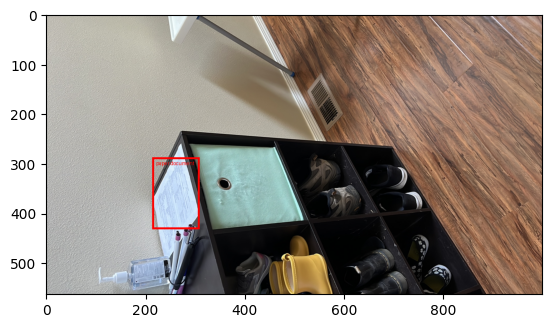

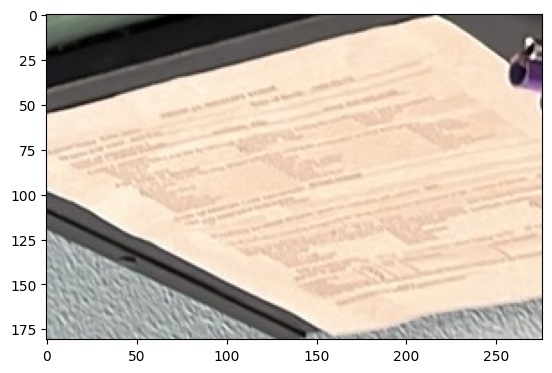

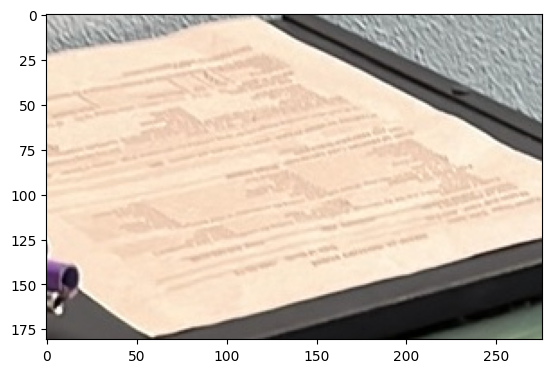

0


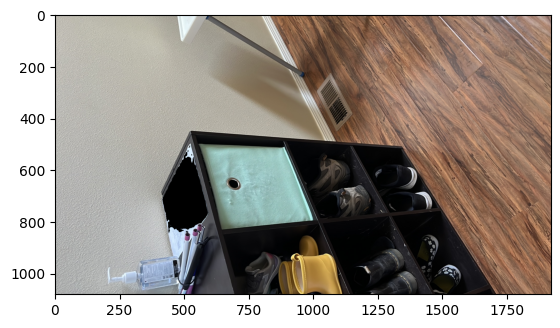

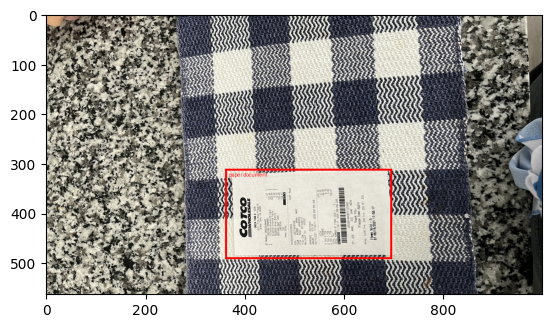

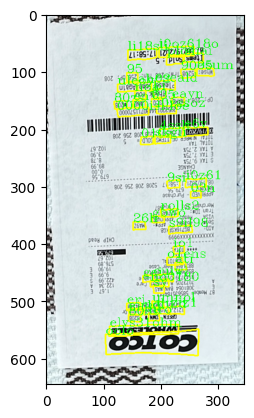

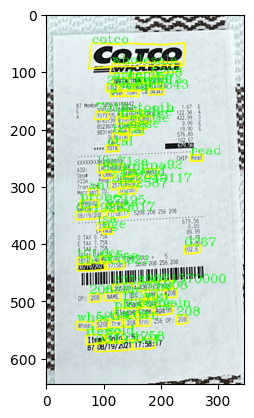

108


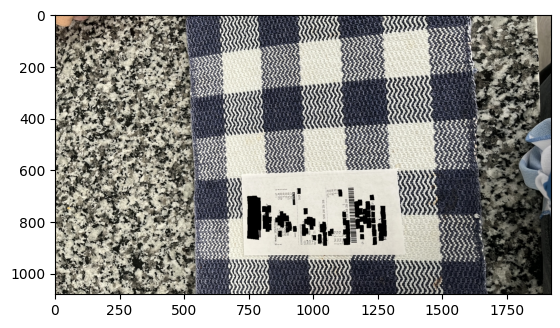

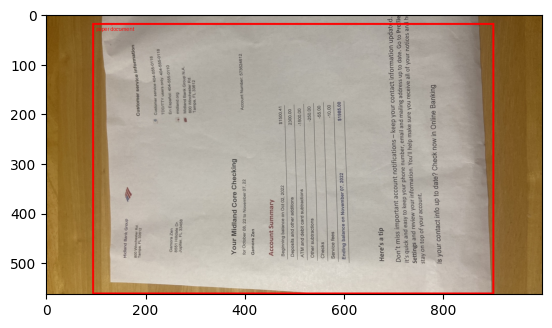

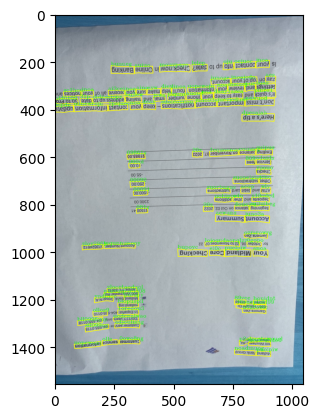

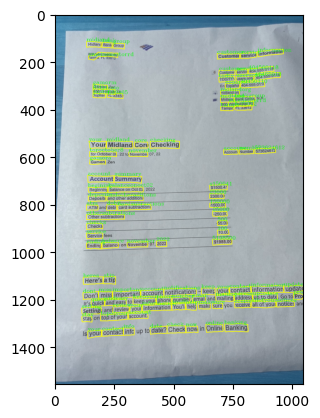

201


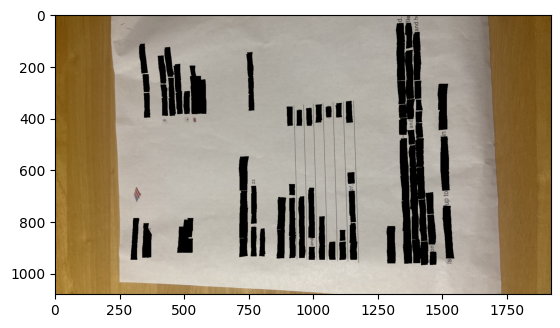

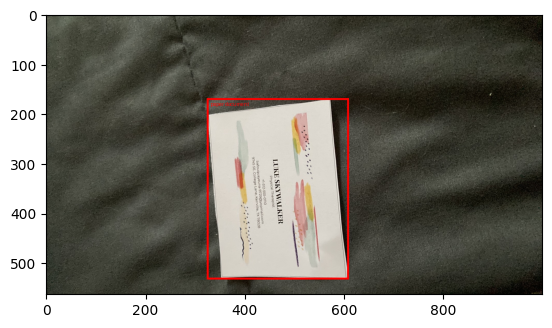

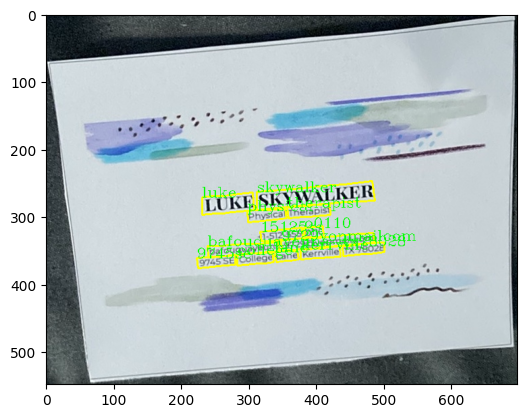

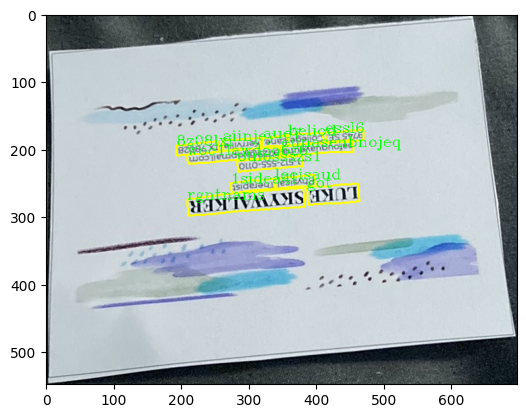

25


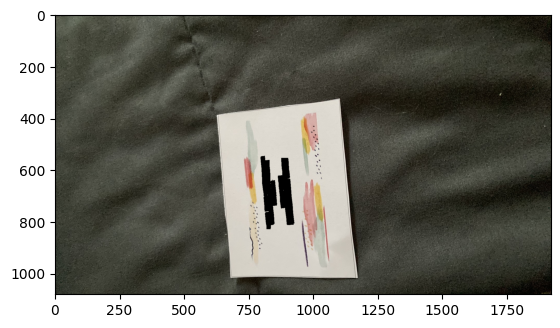

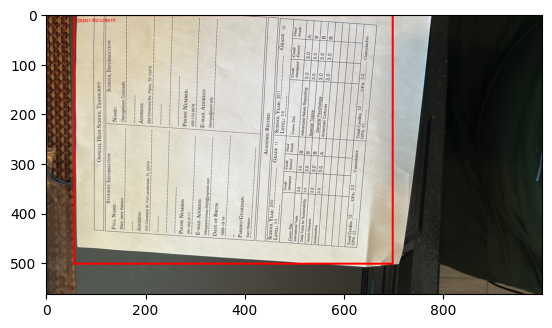

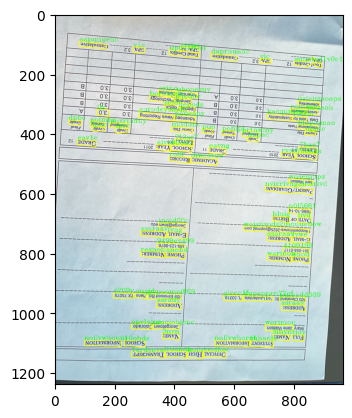

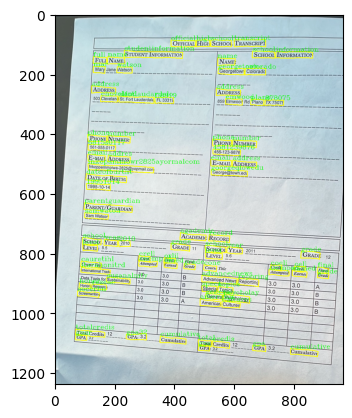

166


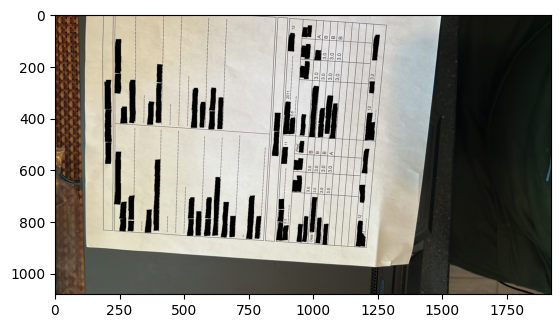

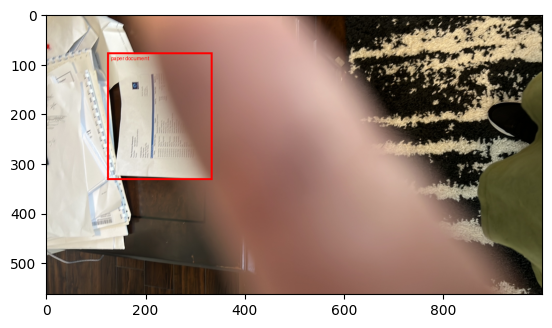

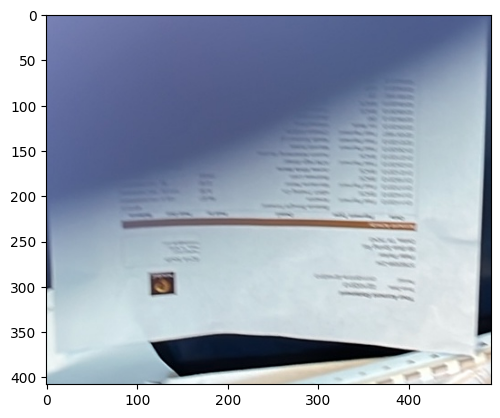

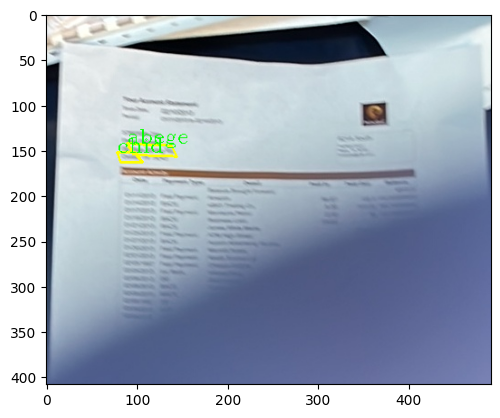

2


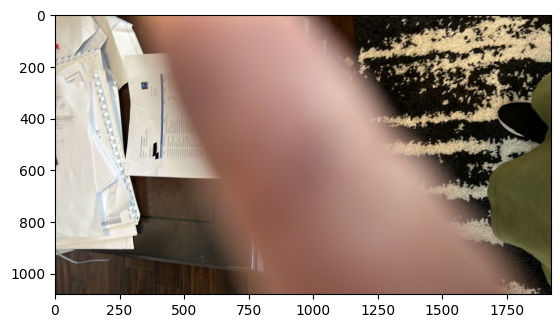

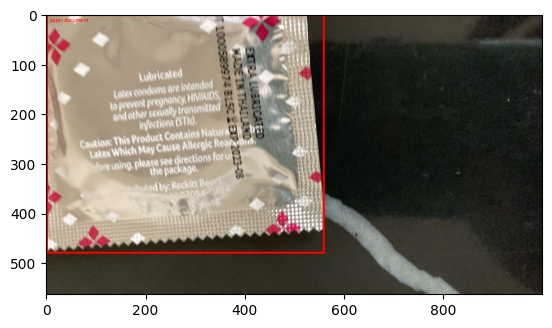

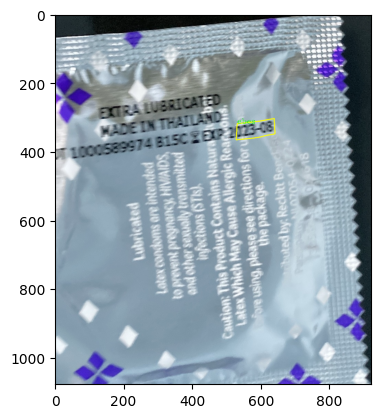

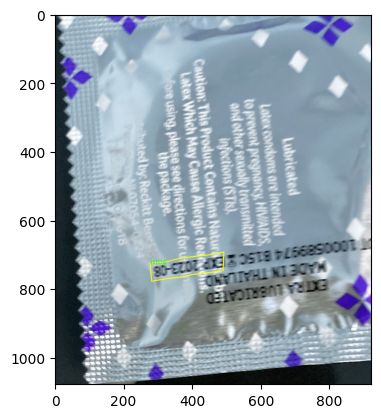

2


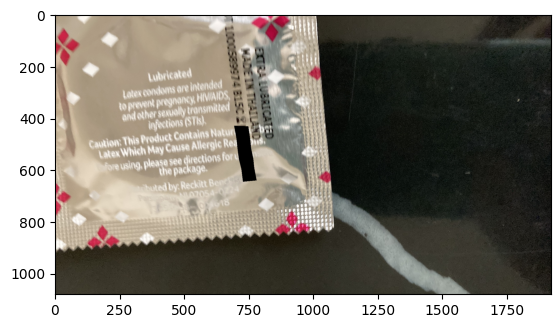

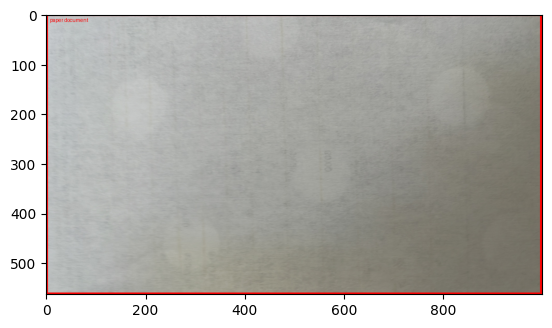

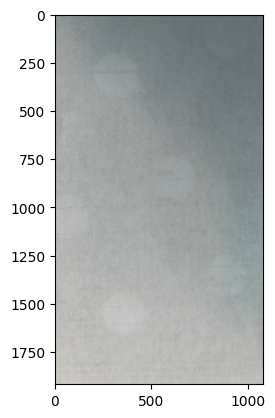

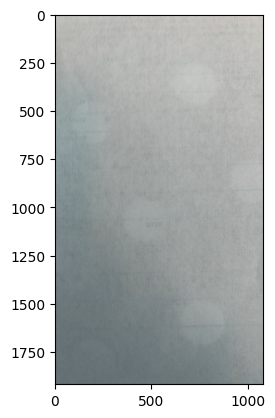

0


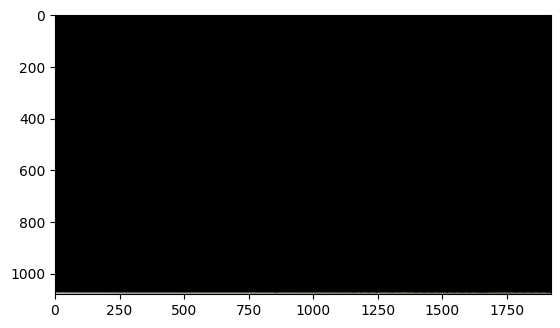

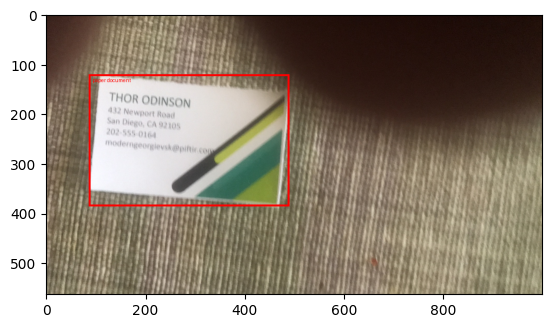

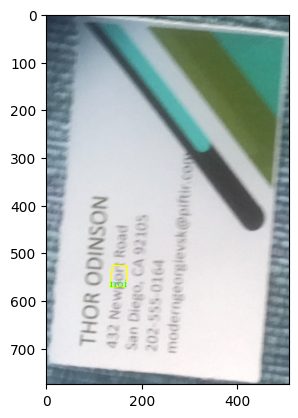

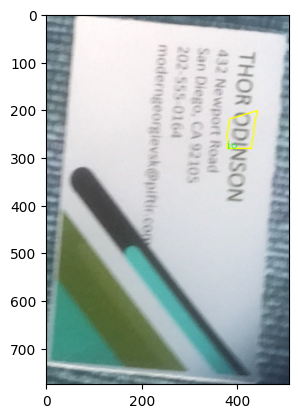

2


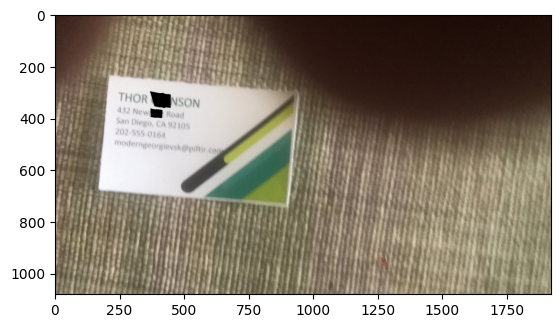

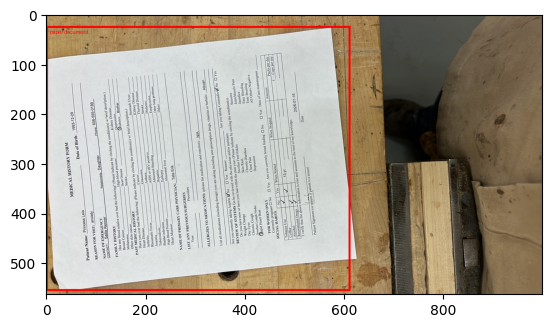

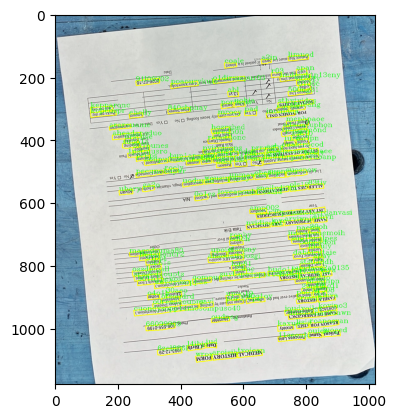

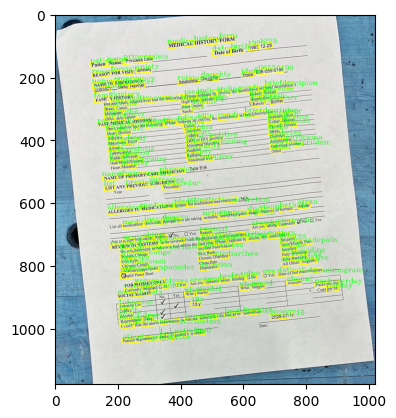

317


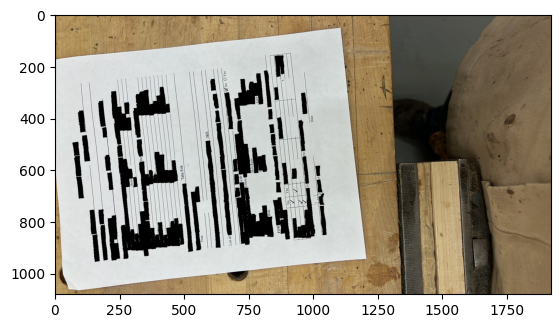

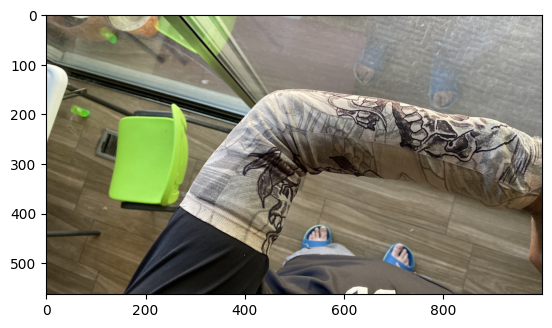

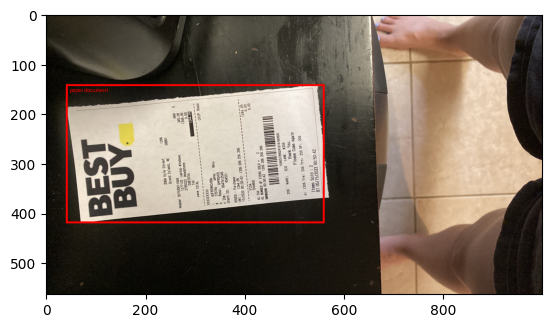

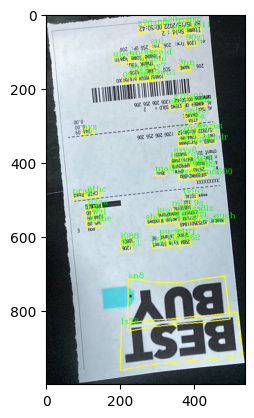

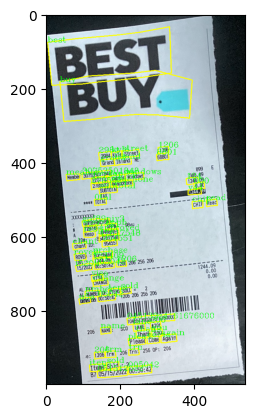

118


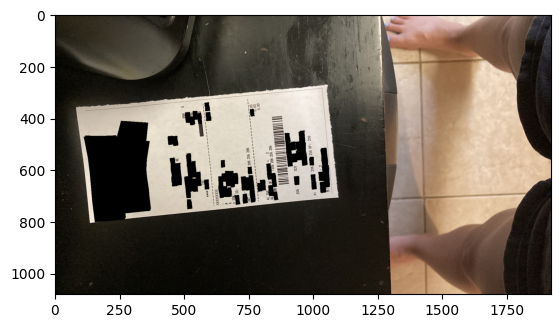

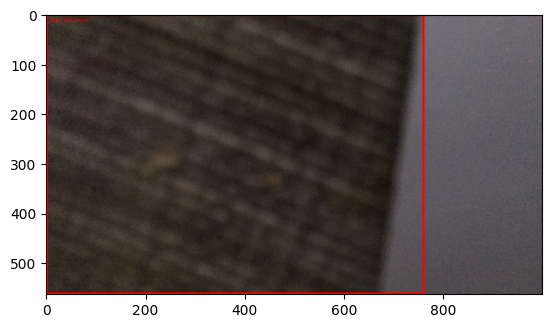

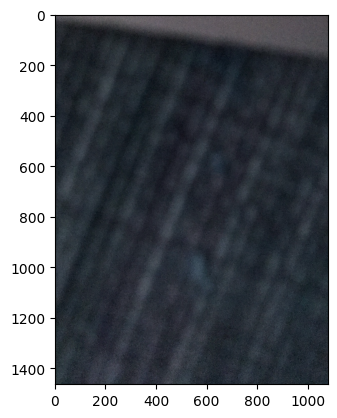

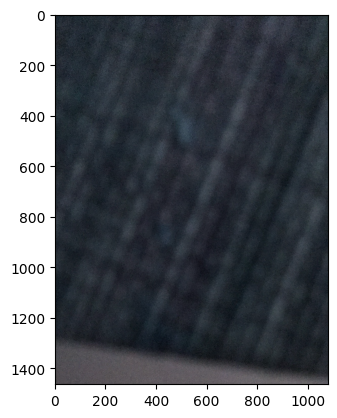

0


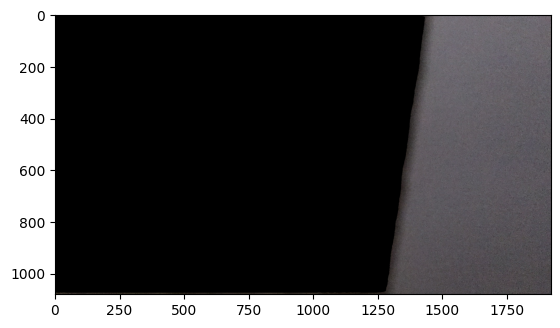

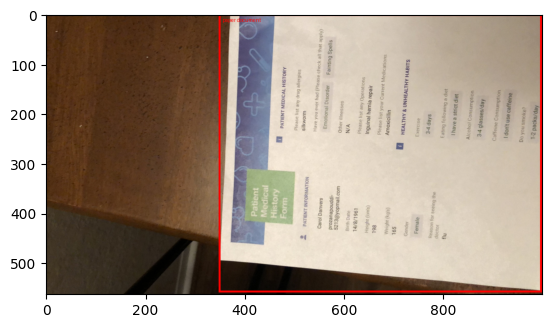

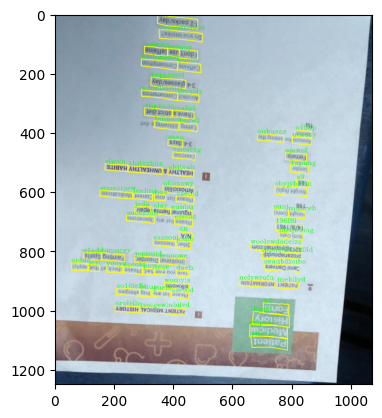

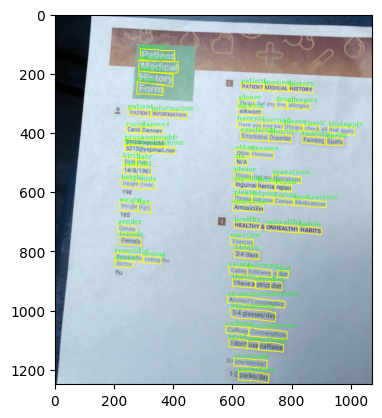

141


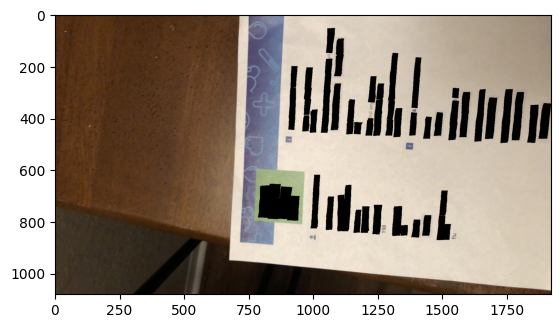

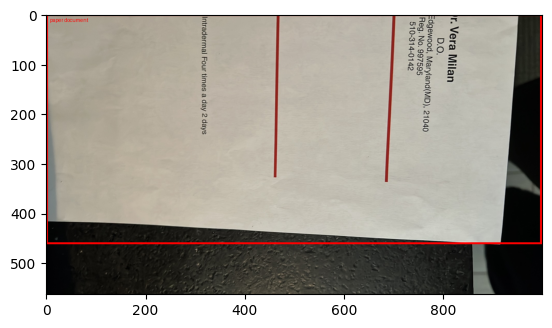

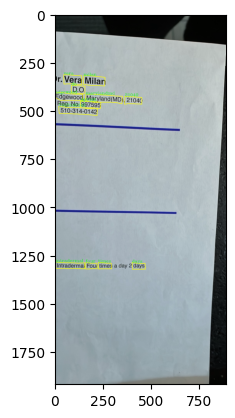

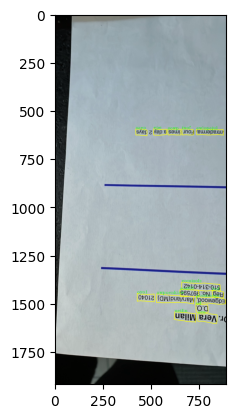

26


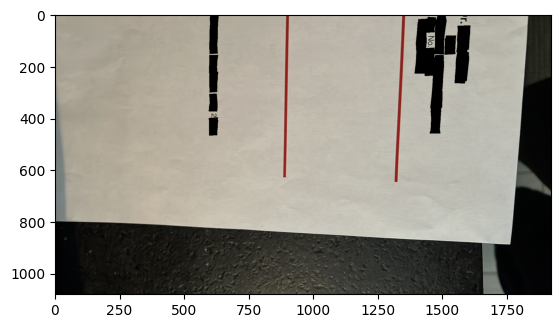

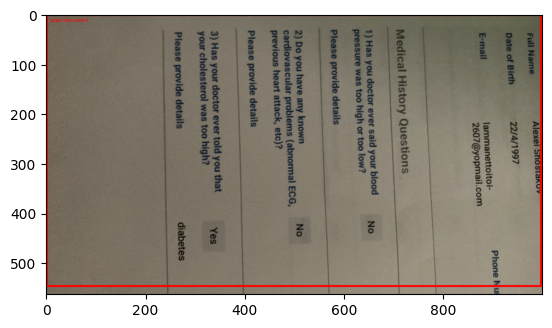

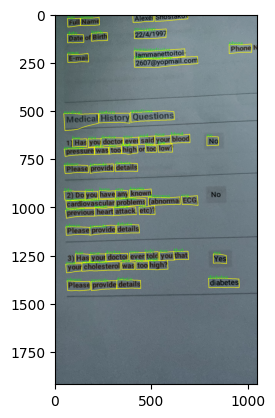

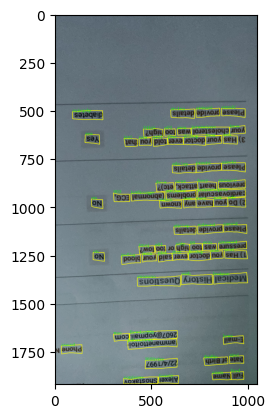

130


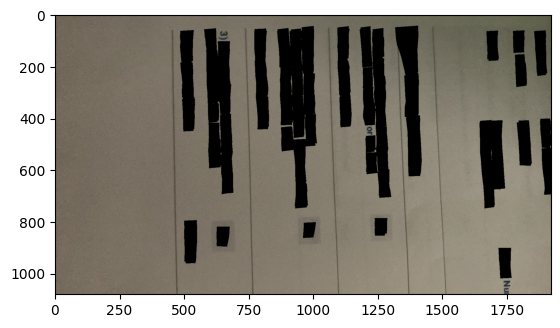

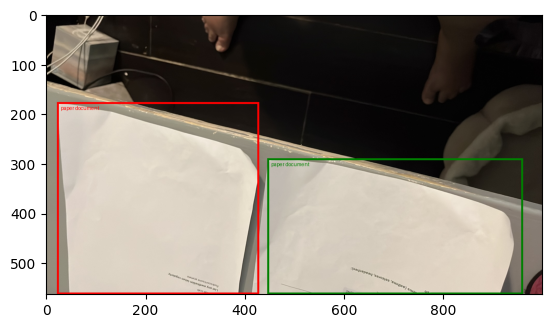

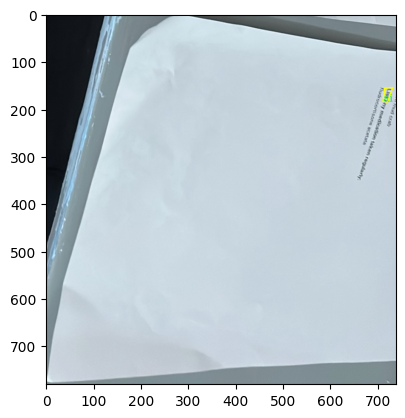

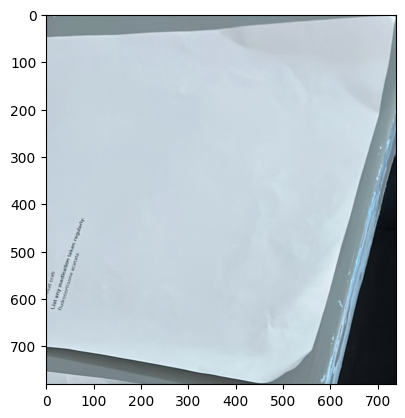

1


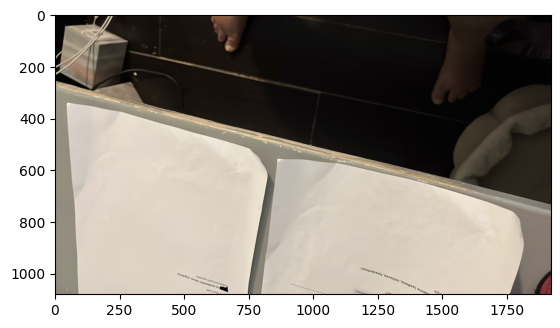

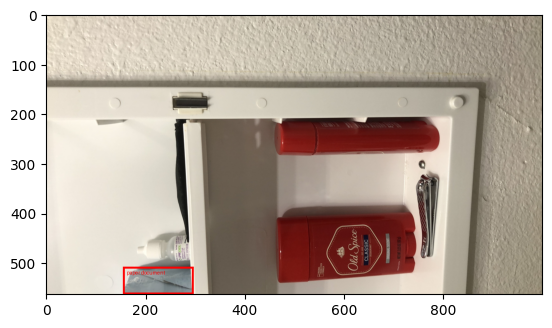

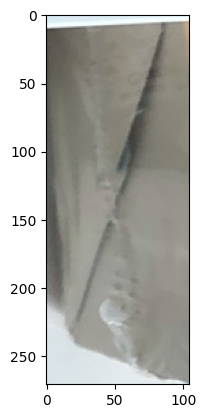

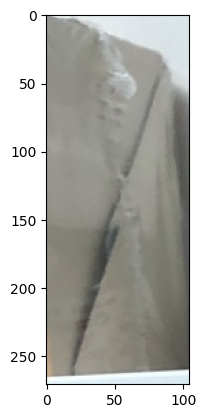

0


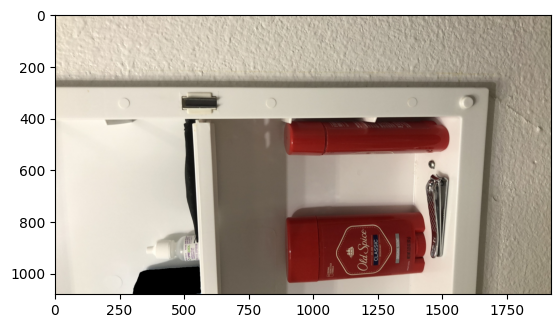

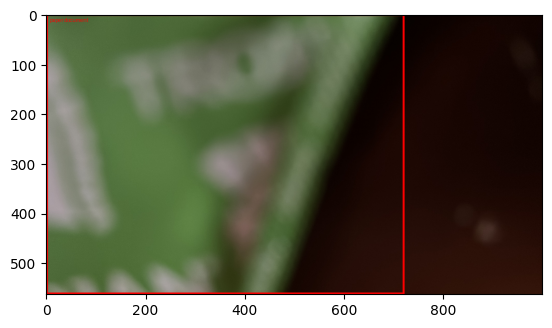

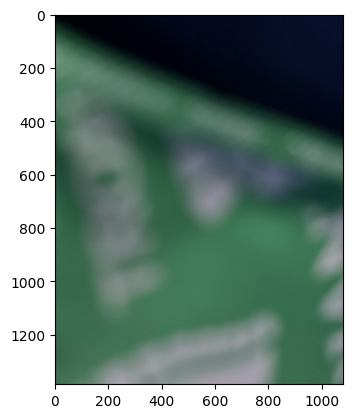

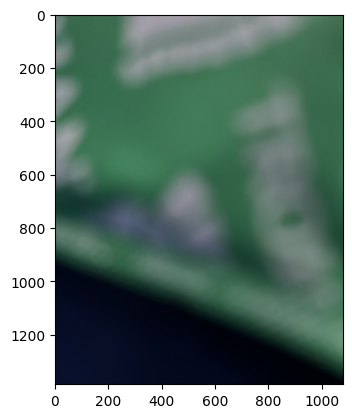

0


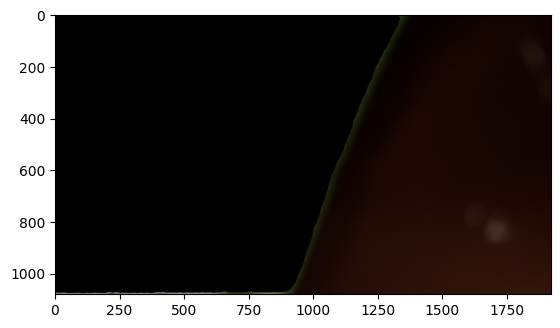

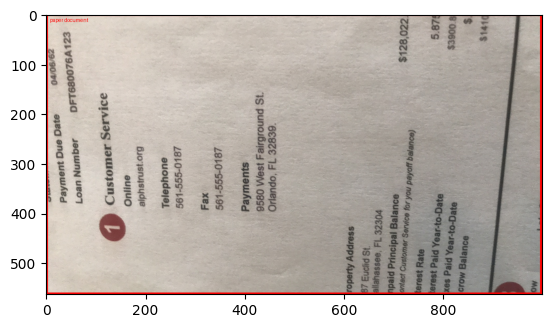

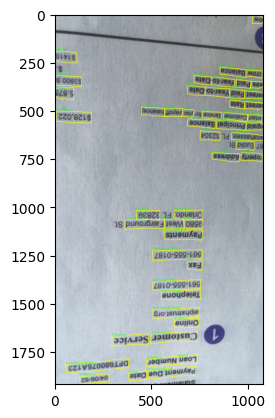

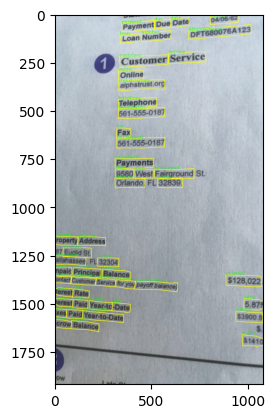

100


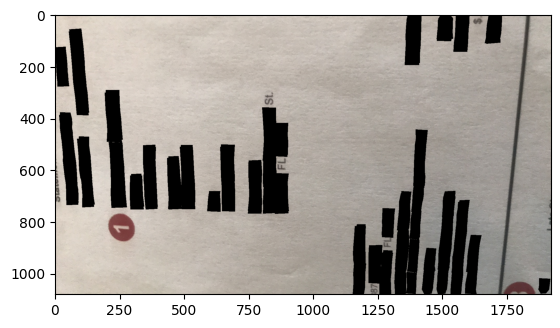

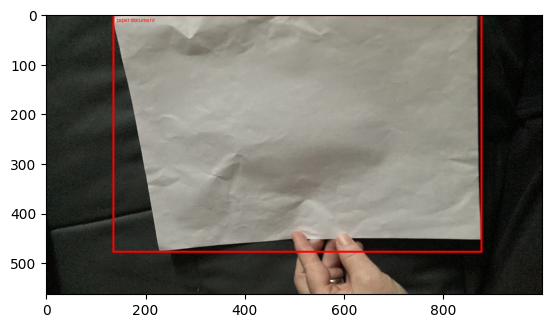

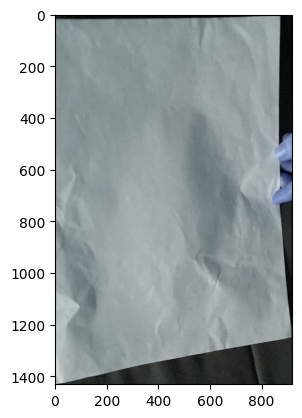

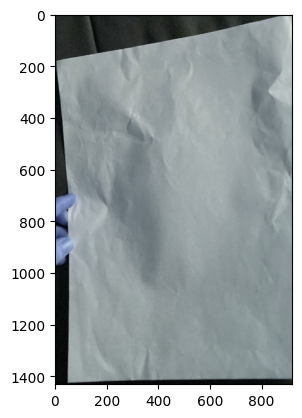

0


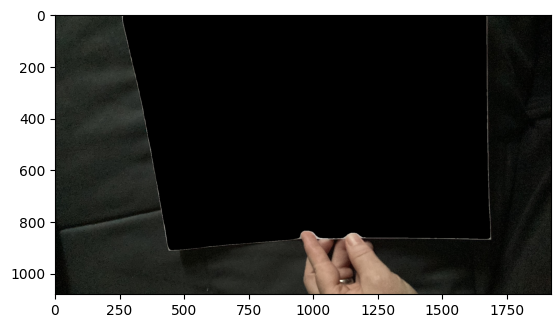

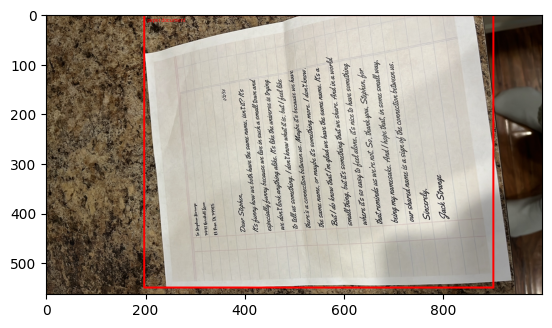

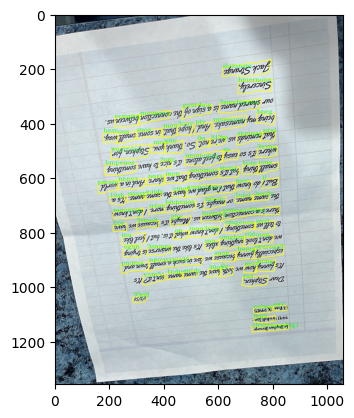

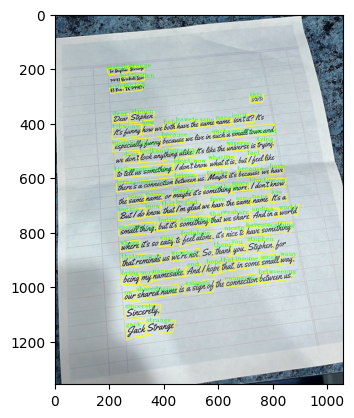

160


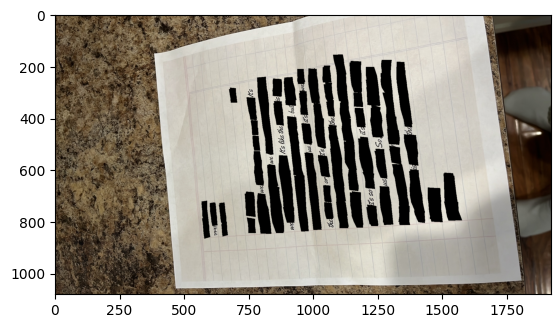

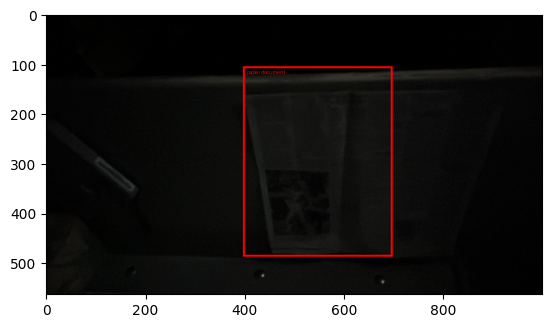

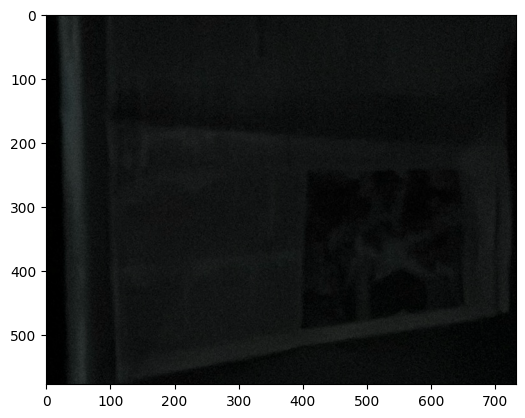

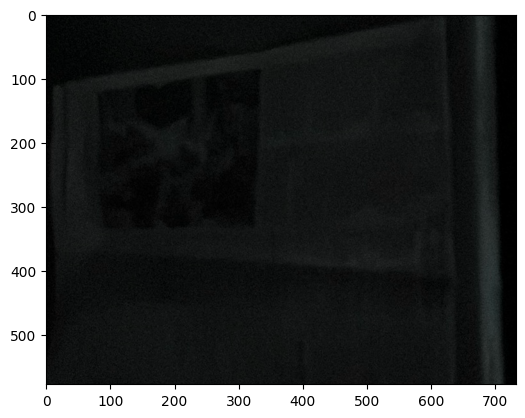

0


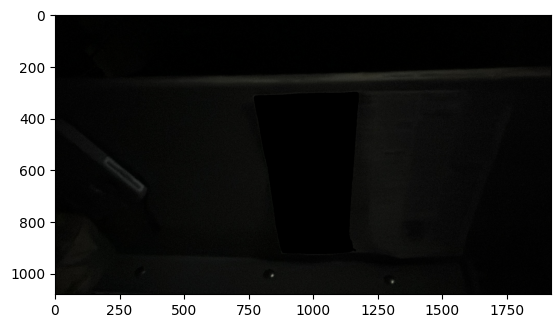

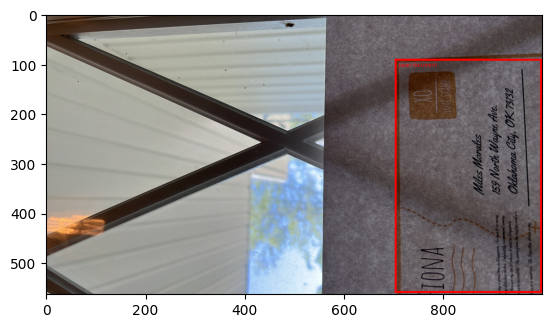

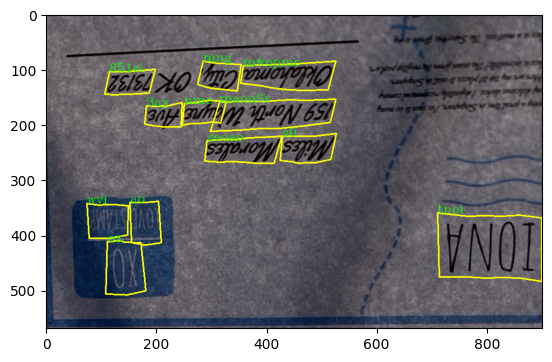

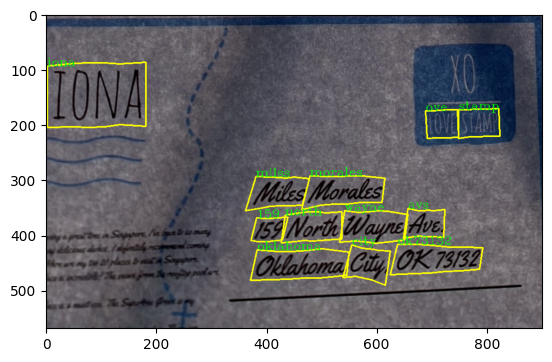

24


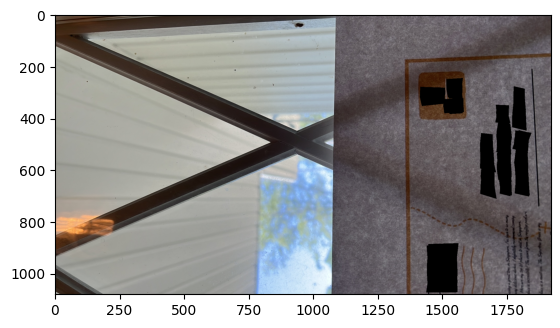

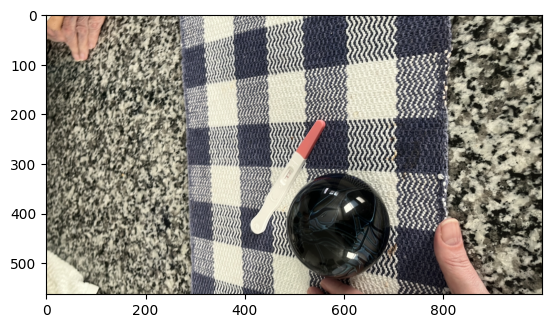

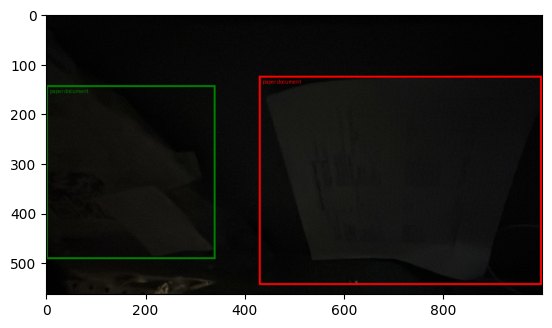

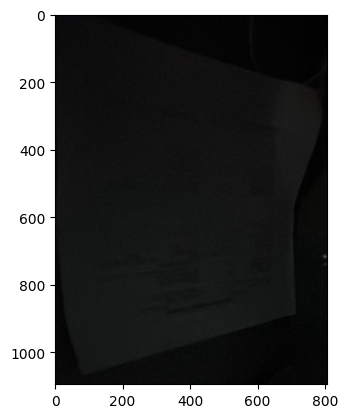

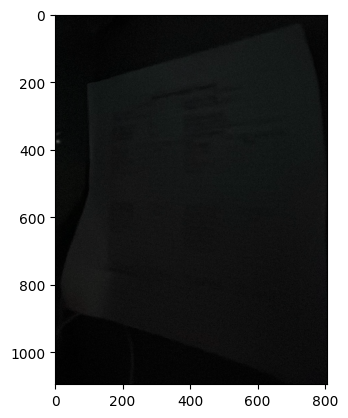

0


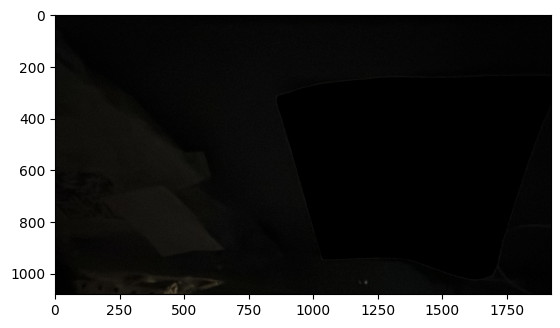

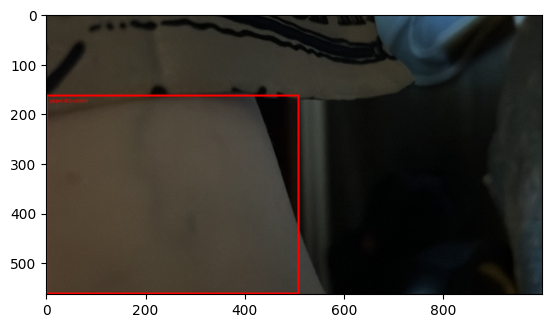

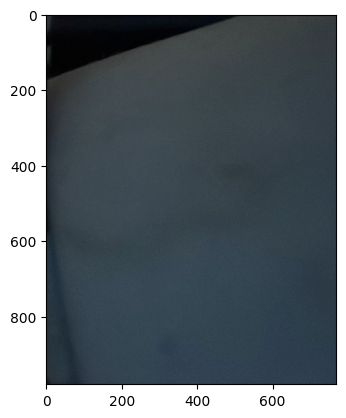

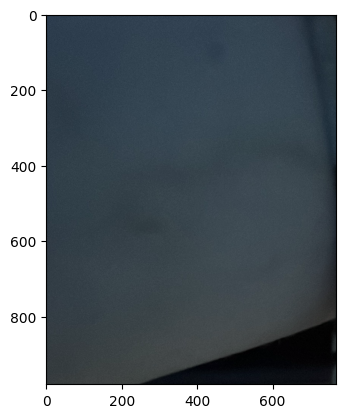

0


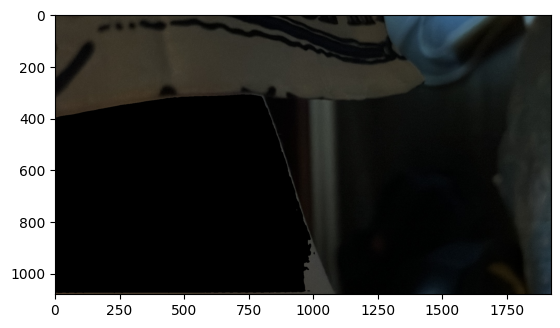

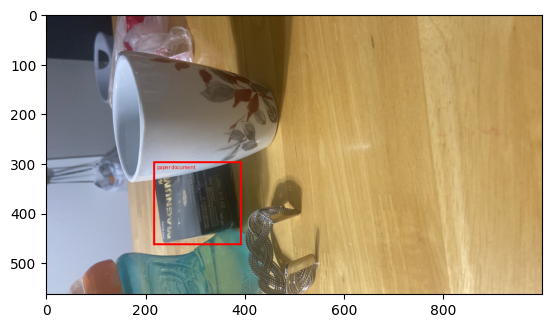

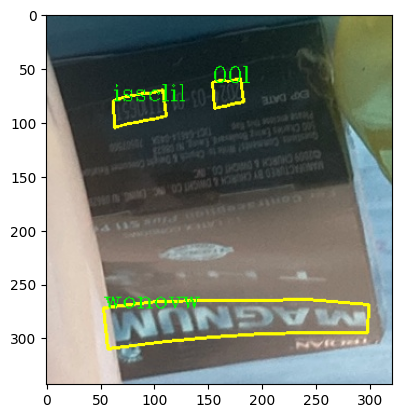

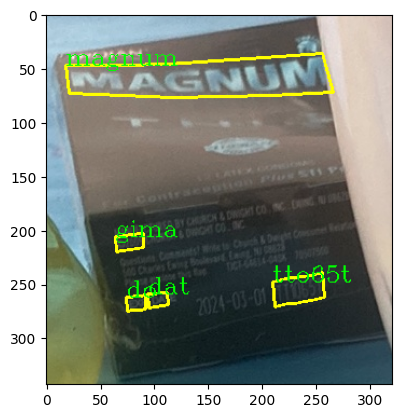

8


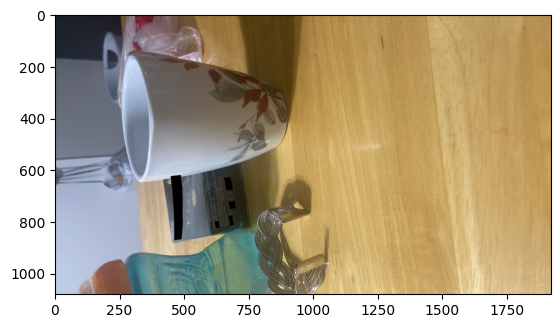

In [ ]:
import glob
import time
from IPython.display import display            

def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    
def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)   
    
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))  
    
def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)


def set_zero_outside_mask(image, mask):
    """Sets pixel values outside the mask to 0."""

    # Ensure image and mask have compatible shapes
    if image.shape[:2] != mask.shape:
        raise ValueError("Image and mask must have the same height and width.")

    # Create a copy of the image to avoid modifying the original
    masked_image = image.copy()

    # Set values outside mask to 0
    masked_image[~mask] = 0

    return masked_image

#folder_path = "/home/jmurrugarral/datasets/BIV-Priv_Image/support_images"

folder_path = "/gpfs/projects/CascanteBonillaGroup/datasets/BIV-Priv_Image/query_images"

# List all files (non-recursively)
files = glob.glob(folder_path + "/*")
#print(files)
#files = [files[1]]#[files[1],files[2],files[3],files[4], files[5], files[6],files[7], files[8]]

mask_generator = SamAutomaticMaskGenerator(sam)
predictor = SamPredictor(sam)

method = 4
homography = False#True
h_replaced = True

for ind, file in enumerate(files):

   #ans, img, bboxes = locate_private_content(file, "Locate paper document in the image, and output in JSON format.", temperature = 1, top_p=0.8)#, show_results = False)    
    image = Image.open(file)
    ans, img, bboxes, _ = locate_private_content(image.copy(), "Locate paper document in the image, and output in JSON format.", temperature = 1, top_p=0.8)#, show_results = False)


    
    plt.imshow(img)
    plt.show()
    
    if bboxes is not None:

        crop_x1,crop_y1,crop_x2,crop_y2  = int(bboxes[0][0]), int(bboxes[0][1]), int(bboxes[0][2]), int(bboxes[0][3])
        
        crop_image = image.copy().crop([crop_x1,crop_y1,crop_x2,crop_y2])
        boxes = []
        w, h = crop_image.size
        
        if w > 28 and h > 28:
            
            _, boxes = rotation_fine_grained(crop_image, method) 

            print(len(boxes))
            if len(boxes) != 0:
                boxes[:,:,0] += crop_x1
                boxes[:,:,1] += crop_y1
            #boxes[:,0] += crop_x1
            #boxes[:,1] += crop_y1
            #boxes[:,2] += crop_x1
            #boxes[:,3] += crop_y1

        predictor.set_image(pil_to_opencv(image))
        bounding_boxes = np.array([bboxes[0][0],bboxes[0][1],bboxes[0][2],bboxes[0][3]])
        masks, _, _ = predictor.predict(point_coords=None, point_labels=None, box=bounding_boxes[None,:], multimask_output=False)

        
        if homography:
            
            y,x = np.where(masks[0]==True)
            crop_x1,crop_y1,crop_x2,crop_y2  = int(np.min(x)), int(np.min(y)), int(np.max(x)), int(np.max(y))
            crop_image = image.copy().crop([crop_x1,crop_y1,crop_x2,crop_y2])
            masks = masks[0][crop_y1:crop_y2,crop_x1:crop_x2]
            
            thresh = (masks*255).astype(np.uint8)#['segmentation'].astype(np.uint8)
            contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
            sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
            #cnt = np.vstack(contours)  # Stack all contours into a single array

            cnt = sorted_contours[0] 
            epsilon = 0.02 * cv2.arcLength(cnt, True)
            corners = cv2.approxPolyDP(cnt, epsilon, True)
            
            #for corner in corners:
            #    cv2.circle(img, tuple(corner[0]), 10, (0, 0, 255), -1)
            #rect = cv2.minAreaRect(cnt)
            #box = cv2.boxPoints(rect)
            #box = box.astype(int)
            #img = cv2.polylines(img, [box], 1, (255,0,0), 2)

            src_points = np.array(corners).reshape(-1,2)
            if len(corners) != 4:
                continue
            
            dst_points = np.array([[0, 0],[0, 1000], [1000, 1000],[1000, 0]], dtype=np.float32)
            H, status  = cv2.findHomography(src_points, dst_points, cv2.RANSAC)
            height, width, channels = (1000, 1000, 3)
            warped_img = cv2.warpPerspective(np.array(crop_image), H, (width, height))

            H_I = np.linalg.inv(H).astype(np.float32)
            _, h_boxes   = rotation_fine_grained(opencv_to_pil(warped_img), method)
            h_boxes      = warp_bboxes(h_boxes, H_I)

            if len(h_boxes) != 0:
                h_boxes[:,:,0] += crop_x1
                h_boxes[:,:,1] += crop_y1 

                if h_replaced:
                    boxes = h_boxes
                else:
                    boxes = np.concatenate((boxes,h_boxes), axis=0)
                
            #boxes[:,0] += crop_x1
            #boxes[:,1] += crop_y1
            #boxes[:,2] += crop_x1
            #boxes[:,3] += crop_y1
        
        if len(boxes) == 0:

            image = pil_to_opencv(image)
            image[masks[0]] = [0,0,0]

            index = str(ind)
            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            plt.show()
            cv2.imwrite('output/result_0_'+index.zfill(3)+'.png', image)        
            
        else:

            cv_image = pil_to_opencv(image)
            for box in boxes:
                cv2.fillPoly(cv_image, [box.astype(np.int32)], color=(0, 0, 0))
                index = str(ind)
            
            plt.imshow(cv2.cvtColor(cv_image,cv2.COLOR_RGB2BGR))
            plt.show()
            cv2.imwrite('output/result_0_'+index.zfill(3)+'.png', cv_image)
             

In [ ]:
img = np.zeros((500, 500, 3), dtype=np.uint8)

# Define polygons (triangles in this case)
polygon1 = np.array([[100, 300], [250, 100], [400, 300]], dtype=np.int32)
polygon2 = np.array([[150, 400], [300, 250], [450, 400]], dtype=np.int32)

# Wrap polygons in a list
polygons = [polygon1, polygon2]

# Fill first polygon with blue color
cv2.fillPoly(img, [polygon1], color=(255, 255, 255))

# Fill second polygon with green color
cv2.fillPoly(img, [polygon2], color=(0, 255, 0))

# Show the image
plt.imshow(img)
plt.show()

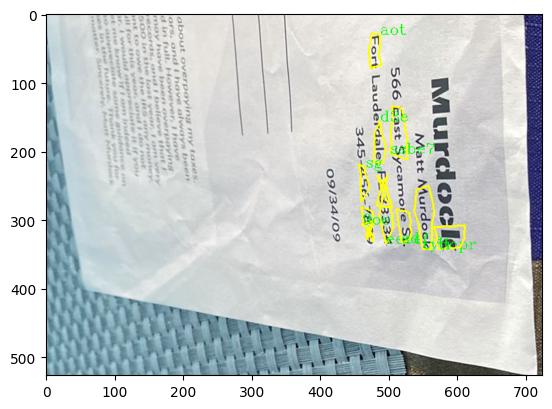

In [19]:
image_file = args.image_dir
img, flag, _ = check_and_read(image_file)
if not flag:
    img = cv2.imread(image_file)
if img is None:
    logger.info("error in loading image:{}".format(image_file))

image_file = '../cropped_image.jpg'
points, strs, elapse = text_detector(img)
src_im = utility.draw_e2e_res(points, strs, image_file)
plt.imshow(src_im)
plt.show()

In [20]:
points[:2], strs, elapse

(array([[[487.,  31.],
         [487.,  41.],
         [487.,  51.],
         [485.,  58.],
         [486.,  62.],
         [489.,  75.],
         [473.,  80.],
         [472.,  67.],
         [471.,  56.],
         [472.,  47.],
         [474.,  39.],
         [475.,  29.]],
 
        [[502., 204.],
         [504., 190.],
         [503., 181.],
         [503., 170.],
         [505., 159.],
         [505., 135.],
         [519., 138.],
         [523., 159.],
         [524., 172.],
         [527., 180.],
         [526., 193.],
         [527., 213.]]]),
 ['aot', 'ssbe7', 'd3e', 'sg', 'eeeefle', 'tydopr', '9oe', 'sd', 'ti'],
 0.28283143043518066)